# Setup
Add the following file to the colab before running the code blocks


*   lfw.tgz [Download here](http://vis-www.cs.umass.edu/lfw/lfw.tgz)
*   mmod_human_face_detector.dat [Download Here](http://dlib.net/files/mmod_human_face_detector.dat.bz2)
*   facenet_keras.h5 [Download here](https://drive.google.com/drive/folders/1o7-0I3jkZbngGIs9NCjwnFkLRpj-QMW2)



Keras is a high-level neural network library that runs on top of TensorFlow.
Keras has a wide selection of predefined layer types, and also supports writing your own layers.
Core layers include Dense (dot product plus bias), Activation (transfer function or neuron shape), Dropout (randomly set a fraction of input units to 0 at each training update to avoid overfitting), Lambda (wrap an arbitrary expression as a Layer object), and several others. Convolution layers (the use of a filter to create a feature map) run from 1D to 3D and include the most common variants, such as cropping and transposed convolution layers for each dimensionality. 2D convolution, which was inspired by the functionality of the visual cortex, is commonly used for image recognition.

## Extract the images from the zip file

In [ ]:
!tar -xvf 'lfw.tgz' -C '.'

Streaming output truncated to the last 5000 lines.
lfw/Luis_Sanchez/
lfw/Luis_Sanchez/Luis_Sanchez_0001.jpg
lfw/Juliette_Binoche/
lfw/Juliette_Binoche/Juliette_Binoche_0001.jpg
lfw/Joel_Todd/
lfw/Joel_Todd/Joel_Todd_0001.jpg
lfw/Allan_Wagner/
lfw/Allan_Wagner/Allan_Wagner_0001.jpg
lfw/Alejandro_Fernandez/
lfw/Alejandro_Fernandez/Alejandro_Fernandez_0001.jpg
lfw/Guillaume_Depardieu/
lfw/Guillaume_Depardieu/Guillaume_Depardieu_0001.jpg
lfw/Delphine_Chuillot/
lfw/Delphine_Chuillot/Delphine_Chuillot_0001.jpg
lfw/Paul_LeClerc/
lfw/Paul_LeClerc/Paul_LeClerc_0001.jpg
lfw/Eddie_Jordan/
lfw/Eddie_Jordan/Eddie_Jordan_0001.jpg
lfw/Lionel_Richie/
lfw/Lionel_Richie/Lionel_Richie_0001.jpg
lfw/Lionel_Richie/Lionel_Richie_0002.jpg
lfw/Jose_Viegas_Filho/
lfw/Jose_Viegas_Filho/Jose_Viegas_Filho_0001.jpg
lfw/Jose_Viegas_Filho/Jose_Viegas_Filho_0002.jpg
lfw/Roger_Mahony/
lfw/Roger_Mahony/Roger_Mahony_0001.jpg
lfw/Clay_Aiken/
lfw/Clay_Aiken/Clay_Aiken_0001.jpg
lfw/Clay_Aiken/Clay_Aiken_0002.jpg
lfw/Clay_Ai

# Importing the required packages for the code

In [ ]:
import os
import cv2
import PIL
from PIL import Image
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.applications.resnet50 import ResNet50
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

## Pulling the images into python's tensorflow dataset

The Image_grid function is to display the images the nearest neighbor search returns.

In [ ]:
def image_grid(array, ncols=5):
    nindex, height, width, intensity = array.shape
    nrows = nindex//ncols
    assert nindex == nrows*ncols
    img_grid = (array.reshape(nrows, ncols, height, width, intensity)
              .swapaxes(1,2)
              .reshape(height*nrows, width*ncols, intensity))
    return img_grid

def create_dataset(img_folder):
    img_data_array=[]
    for file in os.listdir(img_folder):
        if any([file.endswith(x) for x in ['.jpeg', '.jpg']]):
              image_path=os.path.join(img_folder,file)
              image=mpimg.imread(image_path,cv2.COLOR_BGR2RGB)
              img_data_array.append(image)
    return np.array(img_data_array)

Here we create the Training and Testing datasets. We use the same seed.

In [ ]:
train_set = tf.keras.utils.image_dataset_from_directory(
    'lfw',
    validation_split=0.2,
    subset='training',
    seed=123,
    image_size=(250, 250),
    batch_size=1
)

test_set = tf.keras.utils.image_dataset_from_directory(
    'lfw',
    validation_split=0.2,
    subset='validation',
    seed=123,
    image_size=(250,250),
    batch_size=1
)


Found 13233 files belonging to 5749 classes.
Using 10587 files for training.
Found 13233 files belonging to 5749 classes.
Using 2646 files for validation.


## Loading the Model for Feature Extraction
Here we use a pretrained model for ResNet50 called 'imagenet'. We remove the top layer of our model since we don't need to classify the images but just extract the features from the Neural Net. ImageNet is an image database organized in which each node of the hierarchy is depicted by hundreds and thousands of images. The project has been instrumental in advancing computer vision and deep learning research.

In [ ]:
model = ResNet50(weights='imagenet', include_top=False, input_shape = (250,250,3))

94781440/94765736 [==============================] - 1s 0us/step


## Extracting Features
We create two sets of feature data, Train set and Test set. The train set has about 10k images and the test set has 2k images from LFW. We pass the images into our model to extract features. We will be using these features to index our images for Nearest Neighbor Search.

The features from imagenet will decide how good the similarity search is!

In [ ]:
from tqdm import tqdm
from numpy.linalg import norm

def extract_features(img, model):
  features = model.predict(img)
  flattened_feature = features.flatten()
  normalized_feature = flattened_feature / norm(flattened_feature)
  return normalized_feature

train_features = []
train_label_list = []
train_images = []

for images, labels in tqdm(train_set):
  train_features.append(extract_features(images, model))
  train_label_list.append(train_set.class_names[int(labels)])
  train_images.append(images[0].numpy().astype("uint8"))

test_features = []
test_label_list = []
test_images = []

for images, labels in tqdm(test_set):
  test_features.append(extract_features(images, model))
  test_label_list.append(test_set.class_names[int(labels)])
  test_images.append(images[0].numpy().astype("uint8"))

100%|██████████| 2646/2646 [02:53<00:00, 15.26it/s]


We save the features we extracted, the corresponding images, and their labels for future use.

## Indexing the Image Features for NN search
We take the features extracted from the images in the train set and we index them. The following code cell indexes the features we extracted from the training set.

In [ ]:
from sklearn.neighbors import NearestNeighbors

neighbors = NearestNeighbors(n_neighbors = 10, algorithm='brute', metric='euclidean').fit(train_features)



### Visual Test of Image Search Using ResNet50
We search for one of the images in the train and do a visual test to see if the images are similar.

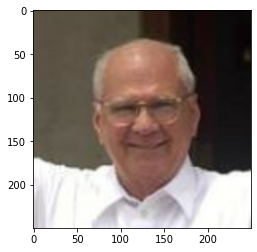

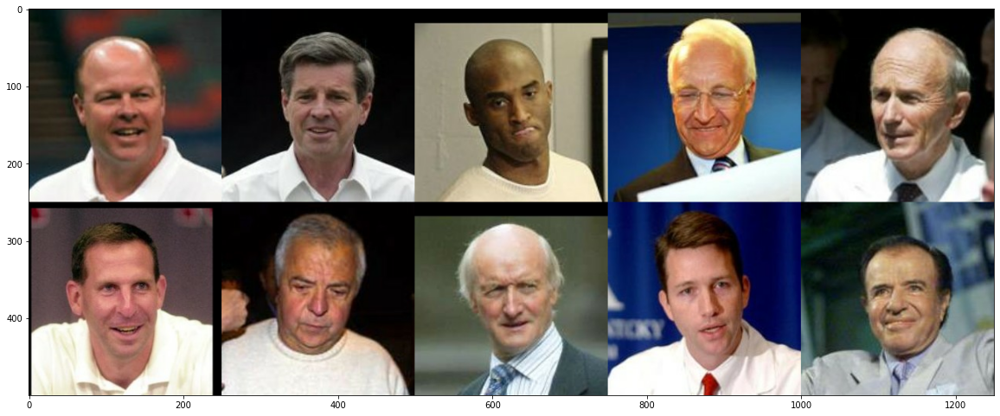

In [ ]:
image_index = 0
plt.imshow(test_images[image_index])
distances, indices = neighbors.kneighbors([test_features[image_index]])
results = []
for i in indices[0]:
  results.append(train_images[i])
result = image_grid(np.array(results))
fig = plt.figure(i,figsize=(20., 20.))
plt.imshow(result)

    

We can see that although the images the nearest neighbor search returned similar images, It could be better. Here all the images returned have white shirts but it doesn't seem to seem to give the face much priority.

We do another test.

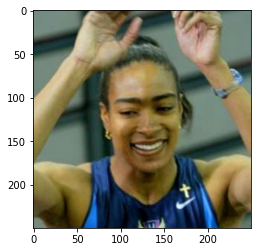

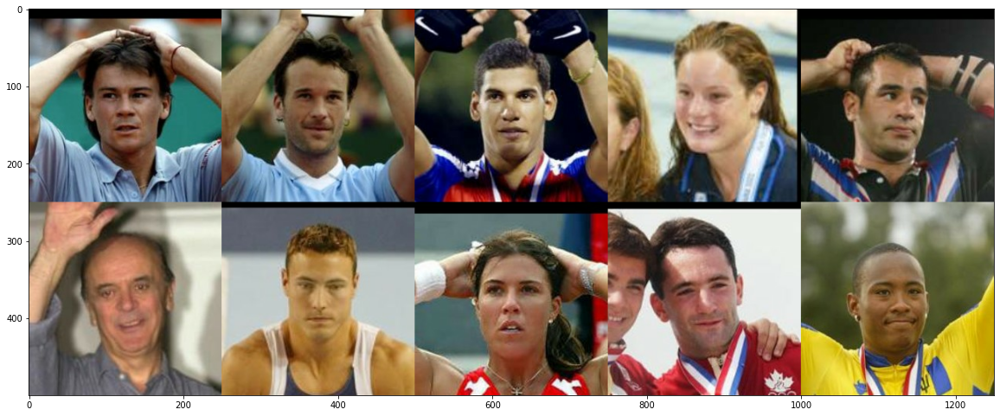

In [ ]:
image_index = 13
plt.imshow(test_images[image_index])
distances, indices = neighbors.kneighbors([test_features[image_index]])
results = []
for i in indices[0]:
  results.append(train_images[i])
result = image_grid(np.array(results))
fig = plt.figure(i,figsize=(20., 20.))
plt.imshow(result)


With this test case, we can see that our search also considers arms and other features not relating to the face while doing similarity search. Here most images are of athletes and they seem to have their arms shown in the images.

**We can possibly improve the search if we were to consider only the faces and use a better model to extract features from these faces**

# Improvement

In order to improve our reverse image search performance, we decided to combine face detection with a better feature extraction model for faces. We replaced ResNet50 with Facenet, a deep neural network used for extracting features from images of face. facenet_keras.h5 is a pretrained keras model using facenet that featches 128 vector embeddings. For face detection, we used Dlib, a C++/Python library that acts as a toolkit for machine learning. Dlib has a convolutional neural network based face detector that is capable of detecting faces at various angles. We originally considered using mtcnn which is another neural network used to detect faces more accurately, but Dlib had better GPU performance.

In [ ]:
from keras.models import load_model
facenet = load_model('facenet_keras.h5')

In the block below we load the face detector, dlib_detector, and define 3 helper functions. dlib_detector takes an image (in the form of an array) as an imput and returns the bounding box coordinates of the detected face. The function convert_and_trim_bb takes the same image and bounding box coordinates, and returns the starting (x,y) coordinate of the bouding box along with its width and height. dlib_extract_face takes an image as an input and and gets the bounding box of the face detected in the image using the detector and previous helping function. In some images, the detector might have trouble detecting the face, so if the detector doesn't return a bounding box, we upscale the image and try to detect again. Upscaling it more than 7 times takes a lot of runtime and and uses a significant amount of RAM, so that is the maximum amount of times the image will be upscaled. dlib_extract_face creates a new image only containing the detected face using the bounding box. The image is then resized to (160,160) pixels so that it can be given to the facenet model.

In [ ]:
import dlib
from numpy import expand_dims
from numpy import asarray
from tqdm import tqdm
dlib_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')

def convert_and_trim_bb(image, rect):
	# extract the starting and ending (x, y)-coordinates of the
	# bounding box
	startX = rect.left()
	startY = rect.top()
	endX = rect.right()
	endY = rect.bottom()
	# ensure the bounding box coordinates fall within the spatial
	# dimensions of the image
	startX = max(0, startX)
	startY = max(0, startY)
	endX = min(endX, image.shape[1])
	endY = min(endY, image.shape[0])
	# compute the width and height of the bounding box
	w = endX - startX
	h = endY - startY
	# return our bounding box coordinates
	return (startX, startY, w, h)
 
def dlib_extract_face(img_array):
  rect = []
  upscale = 0  
  while len(rect) == 0:
    if upscale > 7:
      break
    rect = dlib_detector(img_array, upscale)
    upscale += 1
  for r in rect:
    box = convert_and_trim_bb(img_array, r.rect)
    break
  (x1, y1, w, h) = box
  x1, y1 = abs(x1), abs(y1)
  x2 = abs(x1+w)
  y2 = abs(y1+h)
  store_face = img_array[y1:y2,x1:x2]
  img = Image.fromarray(store_face,'RGB')    
  img = img.resize((160,160))             
  face_array = asarray(img)                 
  return face_array

def dlib_extract_features(img, model):
  img_array = img
  img_array = dlib_extract_face(img_array)
  mean = img_array.mean()
  std = img_array.std()
  img = (img_array-mean)/std
  expanded_img = expand_dims(img, axis=0)
  feature = model.predict(expanded_img)
  return feature[0]

The function dlib_extract_features takes an image and a model (in our case facenet-keras), runs dlib_extract_face to get the image of just the face and then uses the facenet-keras model to return the 128 embeddings.

In [ ]:
fn_train_features = []
fn_train_label_list = []
fn_train_images = []

for images, labels in tqdm(train_set):
  fn_train_label_list.append(train_set.class_names[int(labels)])
  fn_train_images.append(images[0].numpy().astype("uint8"))
  fn_train_features.append(dlib_extract_features(images[0].numpy().astype('uint8'), facenet))

fn_test_features = []
fn_test_label_list = []
fn_test_images = []

for images, labels in tqdm(test_set):
  fn_test_label_list.append(test_set.class_names[int(labels)])
  fn_test_images.append(images[0].numpy().astype("uint8"))
  fn_test_features.append(dlib_extract_features(images[0].numpy().astype('uint8'), facenet))

100%|██████████| 2646/2646 [03:45<00:00, 11.76it/s]


We again use the K-Nearest Neighbor function with the new features.

In [ ]:
from sklearn.neighbors import NearestNeighbors

neighbors = NearestNeighbors(n_neighbors = 10, algorithm='brute', metric='euclidean').fit(fn_train_features)

Visual Litmus Test

<class 'numpy.ndarray'>


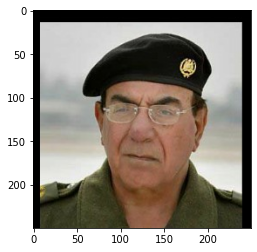

In [ ]:
image_index = 10
distances, indices = neighbors.kneighbors([fn_test_features[image_index]])
print(type(fn_test_images[0]))
plt.imshow(fn_test_images[image_index])

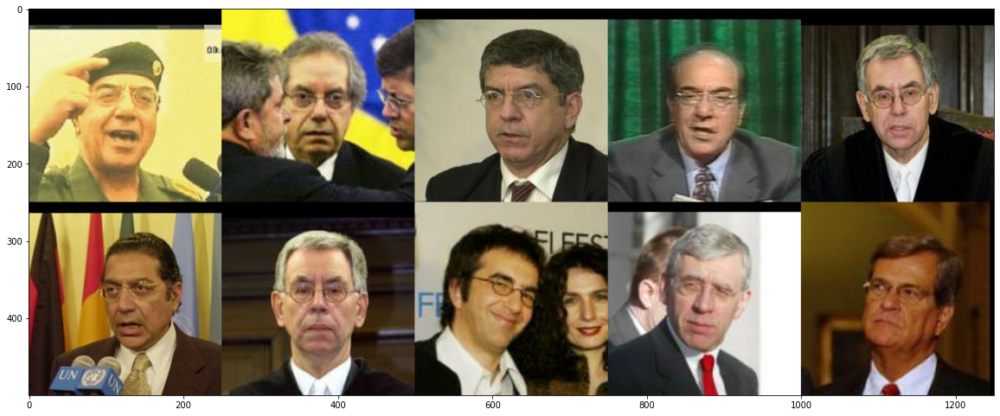

In [ ]:
x = 0
results = []
for i in indices[0]:
  results.append(fn_train_images[i])
result = image_grid(np.array(results))
fig = plt.figure(figsize=(20., 20.))
plt.imshow(result)


We can see that the Similarity search has improved as the images being returned have people who look similar to the image used as a query.



We can now test our Reverse Image Search with the given test case.

In [ ]:
!unzip test.zip

Archive:  test.zip
  inflating: first 10/Albert_Costa_0001.jpg  
  inflating: first 10/Angela_Bassett_0001.jpg  
  inflating: first 10/Arminio_Fraga_0001.jpg  
  inflating: first 10/Billy_Crystal_0001.jpg  
  inflating: first 10/Bob_Graham_0001.jpg  
  inflating: first 10/Boris_Becker_0001.jpg  
  inflating: first 10/Bulent_Ecevit_0001.jpg  
  inflating: first 10/Calista_Flockhart_0001.jpg  
  inflating: first 10/Cameron_Diaz_0001.jpg  
  inflating: first 10/Carmen_Electra_0001.jpg  


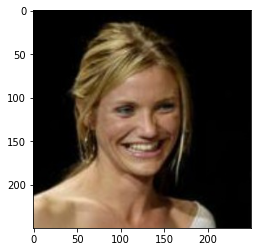

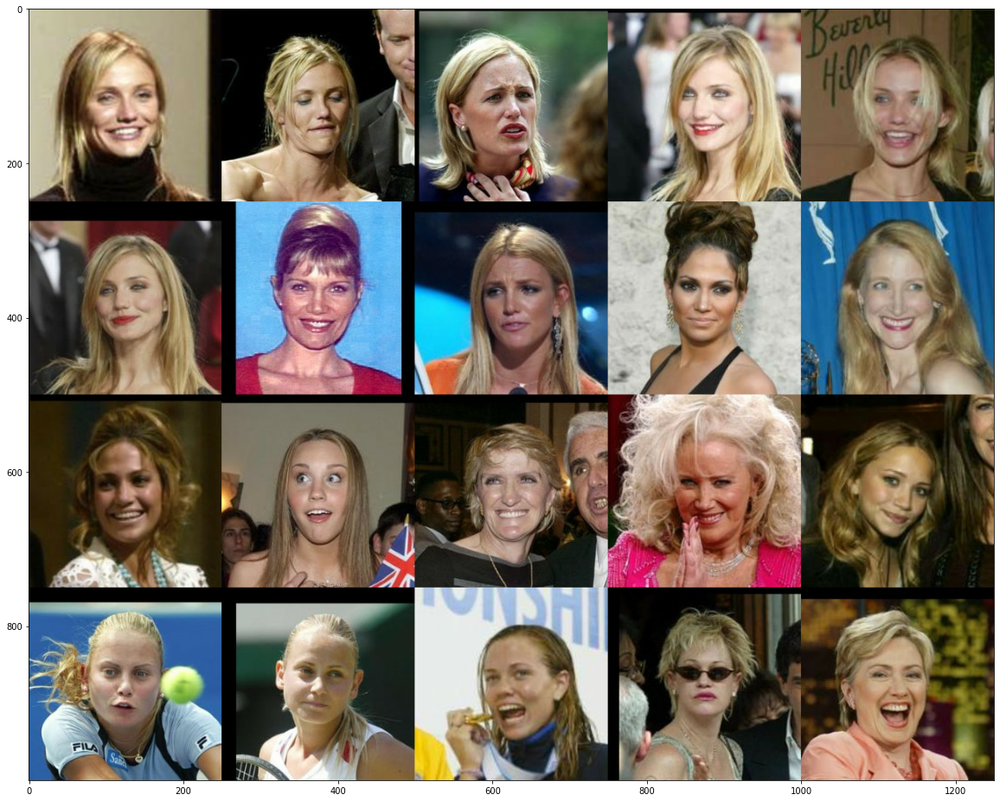

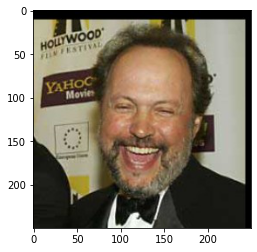

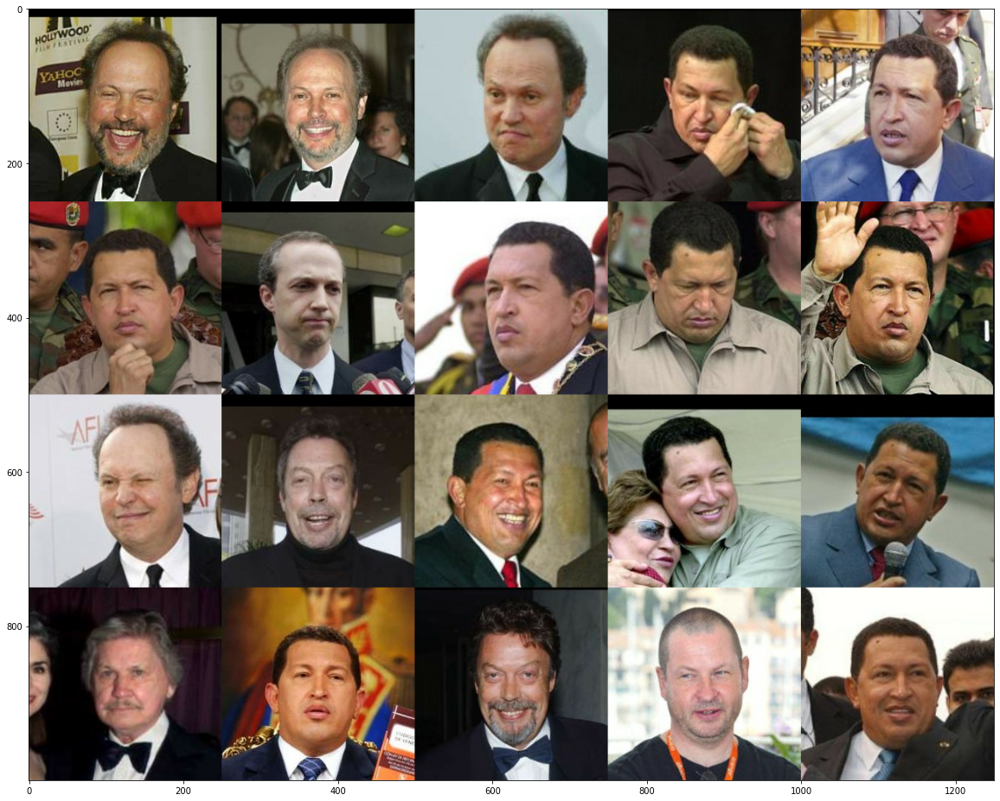

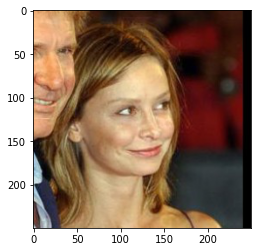

...

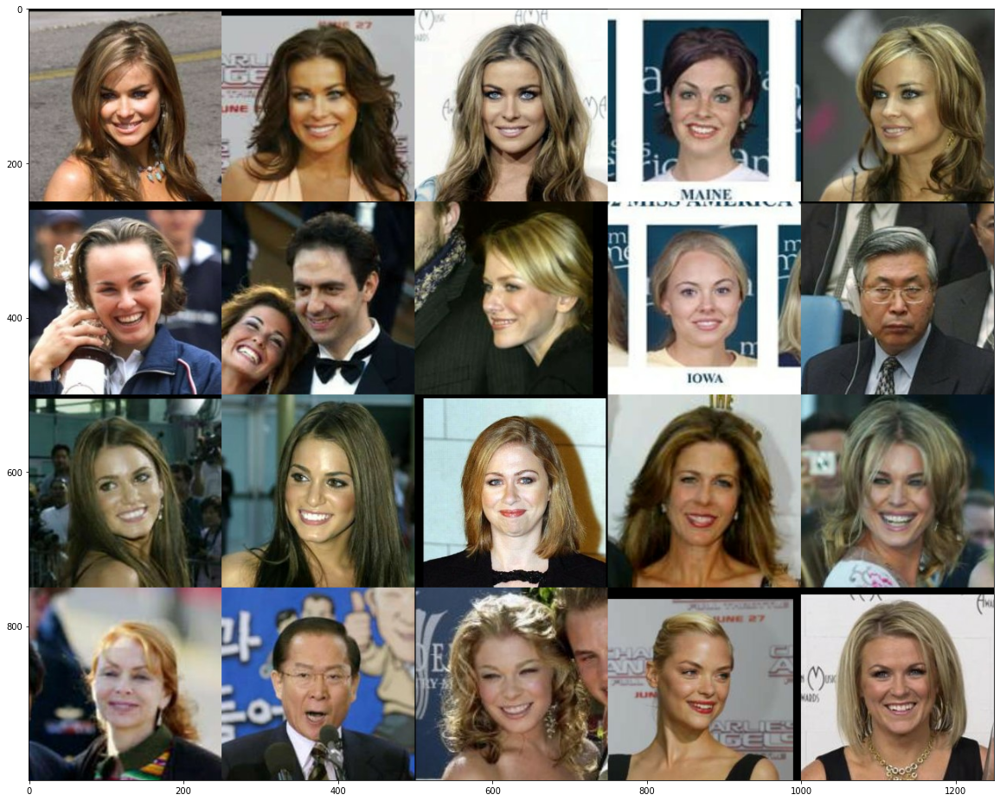

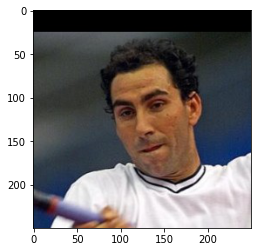

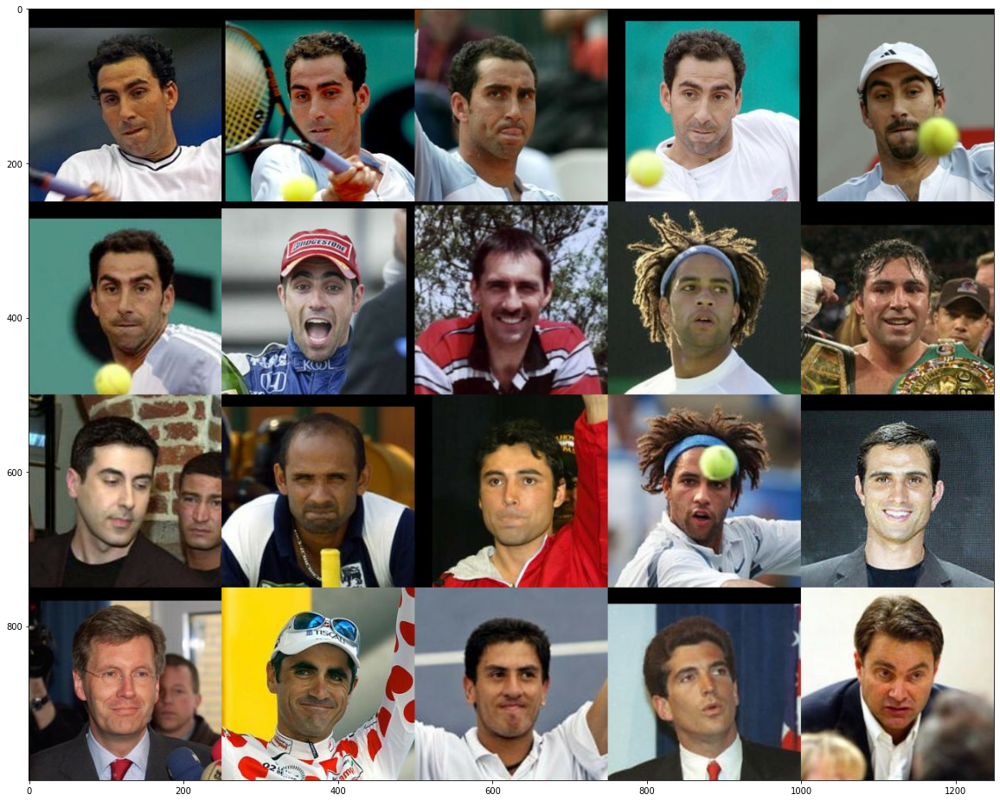

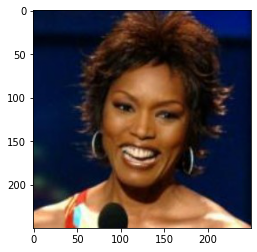

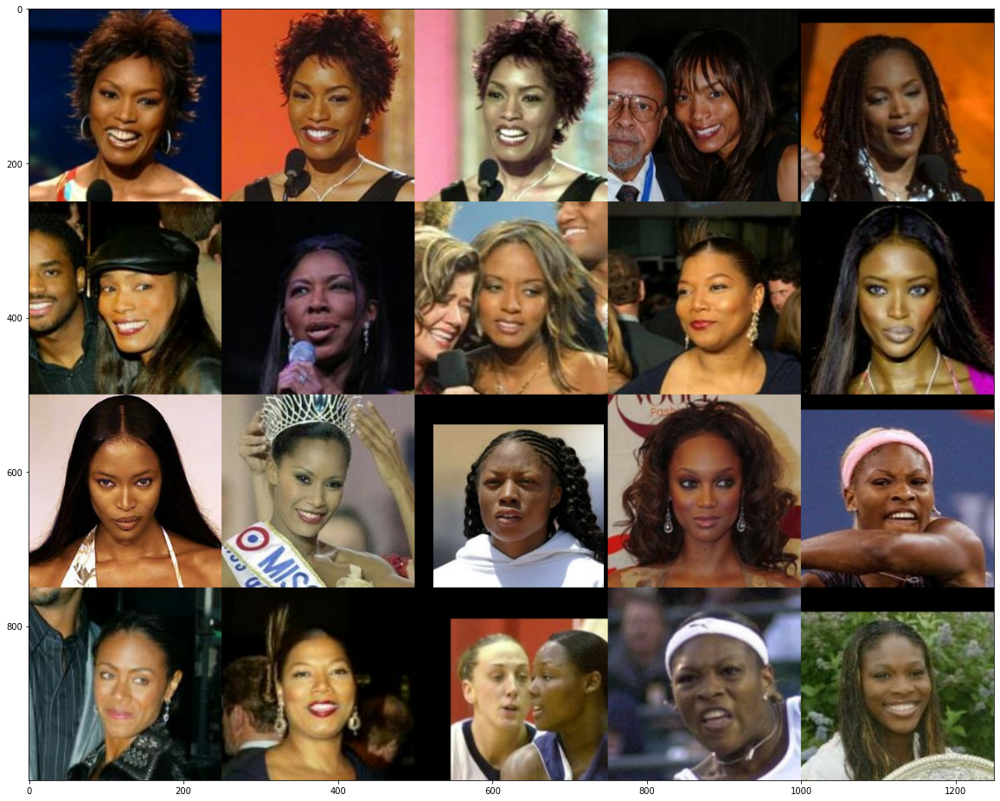

In [ ]:
final_set = create_dataset("first 10")

final_test_features = []

for img in final_set:
  final_test_features.append(dlib_extract_features(img, facenet))

neighbors = NearestNeighbors(n_neighbors = 20, algorithm='brute', metric='euclidean').fit(fn_train_features)

for i in range(len(final_set)):
  img_features = final_test_features[i]
  plt.figure(i)
  plt.imshow(final_set[i])
  distances, indices = neighbors.kneighbors([img_features])
  results = []
  for i in indices[0]:
    results.append(fn_train_images[i])
  result = image_grid(np.array(results))
  fig = plt.figure(i,figsize=(20., 20.))
  plt.imshow(result)


We can see that our Search has improved drastically as it returns images of people who have similar faces(Most of the time). 

# Appendix


*   [Deep Face Reconition with Keras](http://krasserm.github.io/2018/02/07/deep-face-recognition/)
*   [Image Classification TensorFlow](https://www.tensorflow.org/tutorials/images/classification)
*   [Image Classifier with ResNet50 Deep Learning Model](https://medium.com/@venkinarayanan/tutorial-image-classifier-using-resnet50-deep-learning-model-python-flask-in-azure-4c2b129af6d2#:~:text=So%20Resnet50%20stands%20for%20Residual,the%20classification%20and%20recognition%20accuracy)
*   [Dlib Library](http://dlib.net/python/index.html#)
